## Step 1: Create YAML file

In [1]:
# Defining the dataset configuration in a YAML file:
yaml_content = """
train: /kaggle/input/dataset-traffic/images
val:  /kaggle/input/dataset-traffic/images

nc: 7
names: ['Car', 'Number Plate', 'Blur Number Plate', 'Two Wheeler', 'Auto', 'Bus', 'Truck']
"""

# Specify the path for dataset.yaml
yaml_path = '/kaggle/working/dataset.yaml'

# Write the YAML content to the file
with open(yaml_path, 'w') as file:
    file.write(yaml_content)

print(f"dataset.yaml has been saved to: {yaml_path}")

dataset.yaml has been saved to: /kaggle/working/dataset.yaml


## Step 2: Training the Model

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.8/978.8 kB 16.6 MB/s eta 0:00:00


In [3]:
!yolo detect train data=/kaggle/working/dataset.yaml model=yolo11s.pt epochs=50 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100%|██████████████████████████████████████| 18.4M/18.4M [00:00<00:00, 30.6MB/s]
Ultralytics 8.3.110 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/kaggle/working/dataset.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=

## Step 3: Reviewing Training Results

In [4]:
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt

In [5]:
results_path = '/kaggle/working/runs/detect/train/results.csv'

results = pd.read_csv(results_path)

In [6]:
results

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,15.1531,1.31588,3.55310,1.18945,0.17495,0.15991,0.15656,0.12126,0.98563,1.95651,1.01040,0.000055,0.000055,0.000055
1,2,19.5182,1.05488,1.97585,1.05414,0.77476,0.26026,0.28107,0.20194,0.95801,3.42721,0.98961,0.000116,0.000116,0.000116
2,3,23.8781,1.03025,1.30673,1.01470,0.68381,0.37452,0.38479,0.26451,0.97618,2.24633,0.97908,0.000175,0.000175,0.000175
3,4,28.0640,1.01787,1.14107,1.00692,0.70372,0.39169,0.45331,0.32564,0.88476,1.50360,0.93034,0.000231,0.000231,0.000231
4,5,32.0570,0.99057,1.06978,0.99063,0.54479,0.52292,0.53206,0.34604,0.92081,1.31524,0.93529,0.000285,0.000285,0.000285
5,6,36.2066,0.99234,1.09942,0.99258,0.54478,0.60700,0.58950,0.36455,0.97051,1.57242,0.96496,0.000336,0.000336,0.000336
6,7,40.2884,0.95406,0.92582,0.97097,0.62753,0.61410,0.64966,0.41476,0.95643,1.22355,0.96899,0.000384,0.000384,0.000384
7,8,44.1124,0.91978,0.86348,0.96337,0.75407,0.62381,0.70762,0.46830,0.90245,1.07172,0.94595,0.000431,0.000431,0.000431
8,9,47.9509,0.87847,0.78531,0.94661,0.68450,0.68566,0.71941,0.47301,0.88352,0.94744,0.93916,0.000474,0.000474,0.000474
9,10,51.6087,0.88352,0.77410,0.95233,0.72259,0.70836,0.75118,0.49727,0.84693,0.78784,0.92551,0.000515,0.000515,0.000515


In [7]:
print(results.columns)

Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')


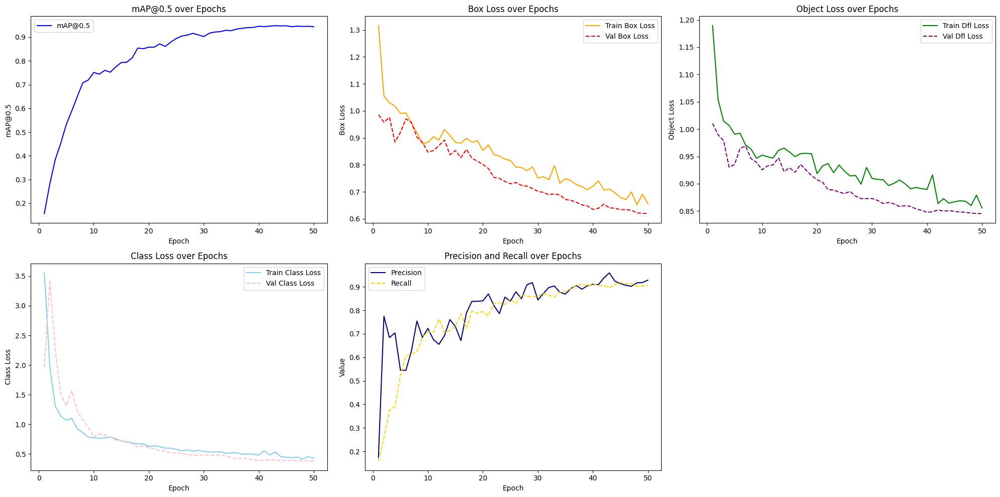

In [8]:
# Plotting results
results = pd.read_csv('/kaggle/working/runs/detect/train/results.csv')

# Plotting
plt.figure(figsize=(20, 10))

# Subplot 1: mAP@0.5 over epochs
plt.subplot(2, 3, 1)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', color='blue')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5')
plt.title('mAP@0.5 over Epochs')
plt.legend()

# Subplot 2: Training and Validation Box Loss
plt.subplot(2, 3, 2)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', color='orange')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', linestyle='--', color='red')
plt.xlabel('Epoch')
plt.ylabel('Box Loss')
plt.title('Box Loss over Epochs')
plt.legend()

# Subplot 3: Training and Validation Object Loss
plt.subplot(2, 3, 3)
plt.plot(results['epoch'], results['train/dfl_loss'], label='Train Dfl Loss', color='green')
plt.plot(results['epoch'], results['val/dfl_loss'], label='Val Dfl Loss', linestyle='--', color='purple')
plt.xlabel('Epoch')
plt.ylabel('Object Loss')
plt.title('Object Loss over Epochs')
plt.legend()

# Subplot 4: Training and Validation Class Loss
plt.subplot(2, 3, 4)
plt.plot(results['epoch'], results['train/cls_loss'], label='Train Class Loss', color='skyblue')
plt.plot(results['epoch'], results['val/cls_loss'], label='Val Class Loss', linestyle='--', color='pink')
plt.xlabel('Epoch')
plt.ylabel('Class Loss')
plt.title('Class Loss over Epochs')
plt.legend()

# Subplot 5: Precision and Recall
plt.subplot(2, 3, 5)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', color='navy')
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', linestyle='--', color='gold')
plt.xlabel('Epoch')
plt.ylabel('Value')
plt.title('Precision and Recall over Epochs')
plt.legend()


plt.tight_layout()
plt.show()

## Step 4: Performing Inference Tests

In [9]:
!yolo detect predict model=runs/detect/train/weights/best.pt source=/kaggle/input/dataset-traffic/images/test save=True

Ultralytics 8.3.110 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11s summary (fused): 100 layers, 9,415,509 parameters, 0 gradients, 21.3 GFLOPs

image 1/20 /kaggle/input/dataset-traffic/images/test/00 (107).jpg: 640x384 1 Car, 1 Blur Number Plate, 1 Two Wheeler, 2 Buss, 2 Trucks, 81.0ms
image 2/20 /kaggle/input/dataset-traffic/images/test/00 (108).jpg: 640x384 2 Cars, 1 Blur Number Plate, 1 Two Wheeler, 2 Buss, 2 Trucks, 8.6ms
image 3/20 /kaggle/input/dataset-traffic/images/test/00 (180).jpg: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Bus, 62.1ms
image 4/20 /kaggle/input/dataset-traffic/images/test/00 (206).jpg: 384x640 3 Cars, 2 Two Wheelers, 1 Bus, 8.6ms
image 5/20 /kaggle/input/dataset-traffic/images/test/00 (265).jpg: 384x640 4 Cars, 1 Blur Number Plate, 1 Bus, 1 Truck, 9.8ms
image 6/20 /kaggle/input/dataset-traffic/images/test/00 (267).jpg: 384x640 4 Cars, 1 Bus, 1 Truck, 8.6ms
image 7/20 /kaggle/input/dataset-traffic/images/test/00 (292).j

## Step 5: Displaying Inference Results

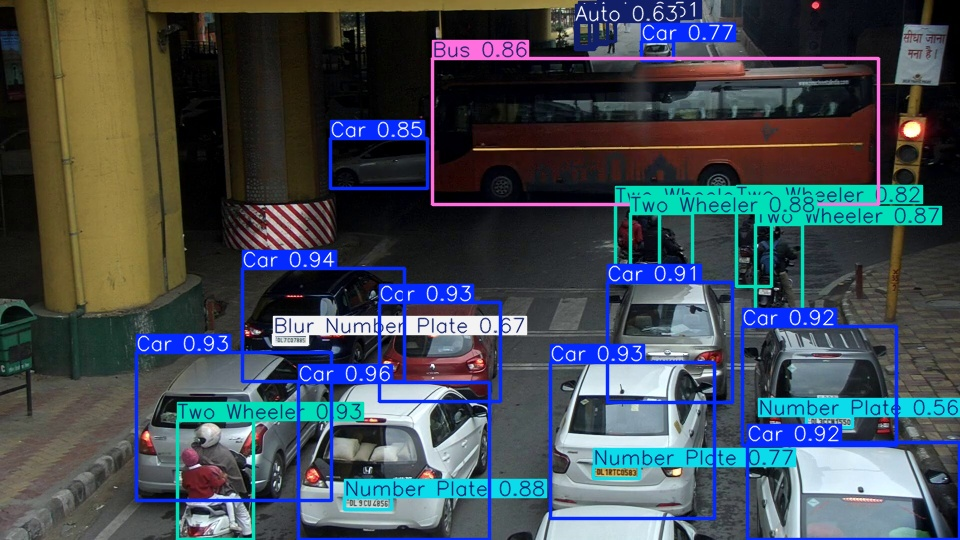

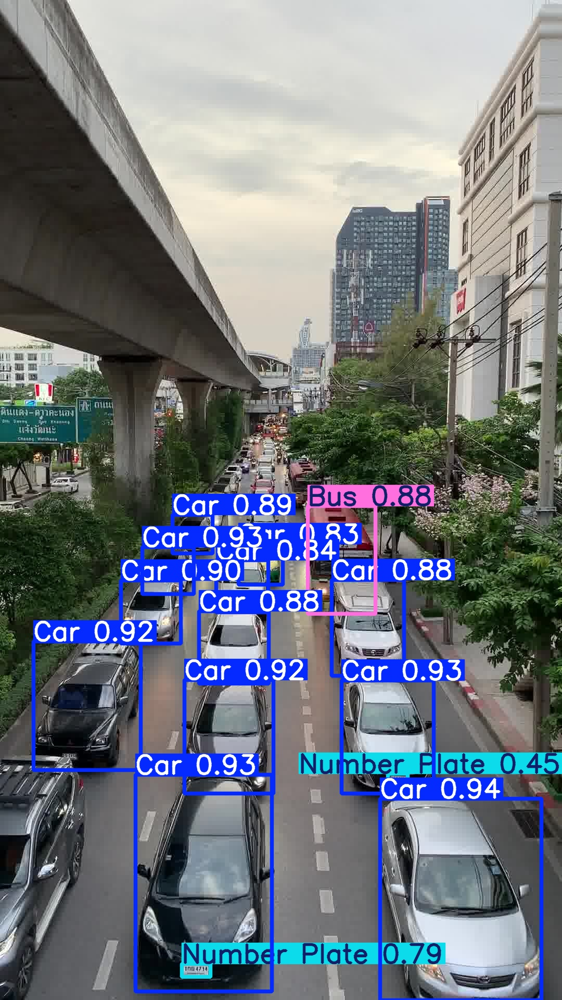

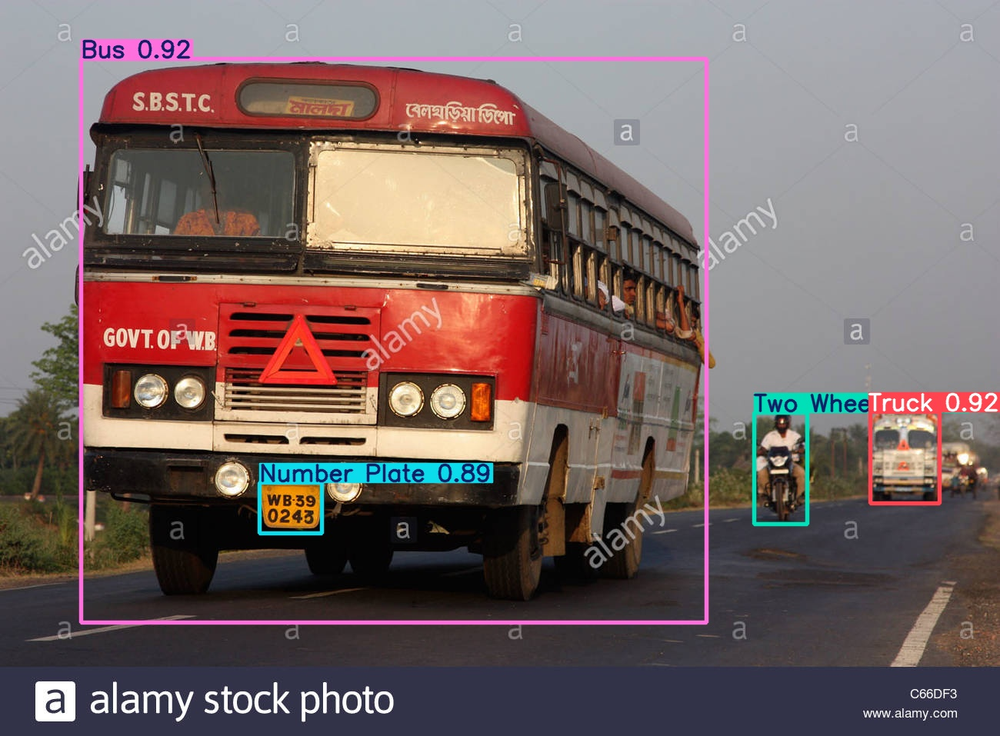

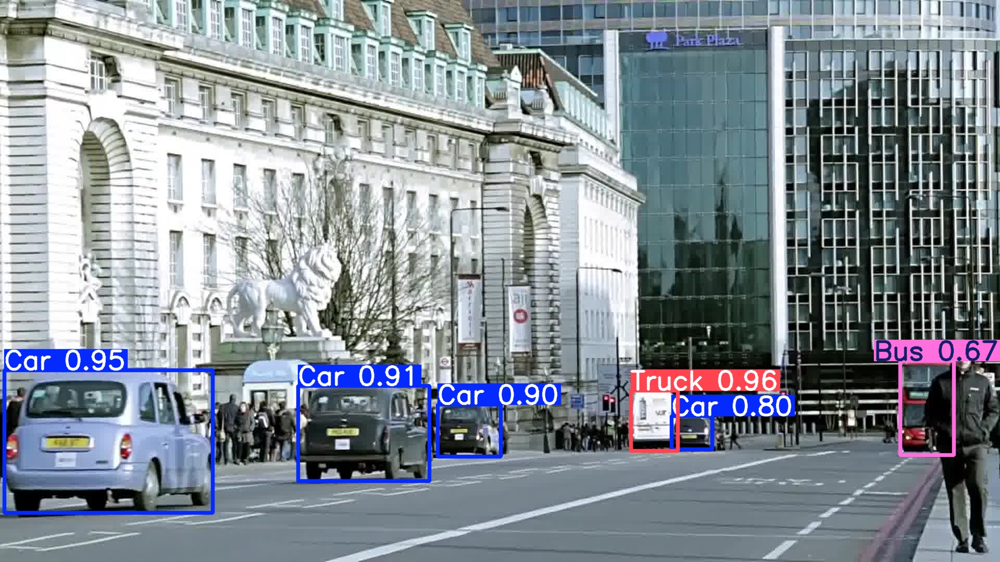

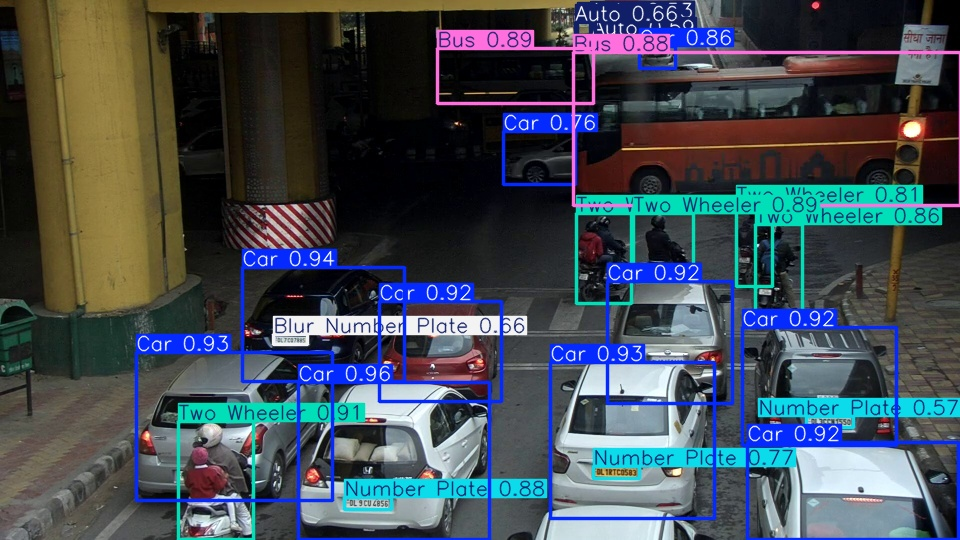

...

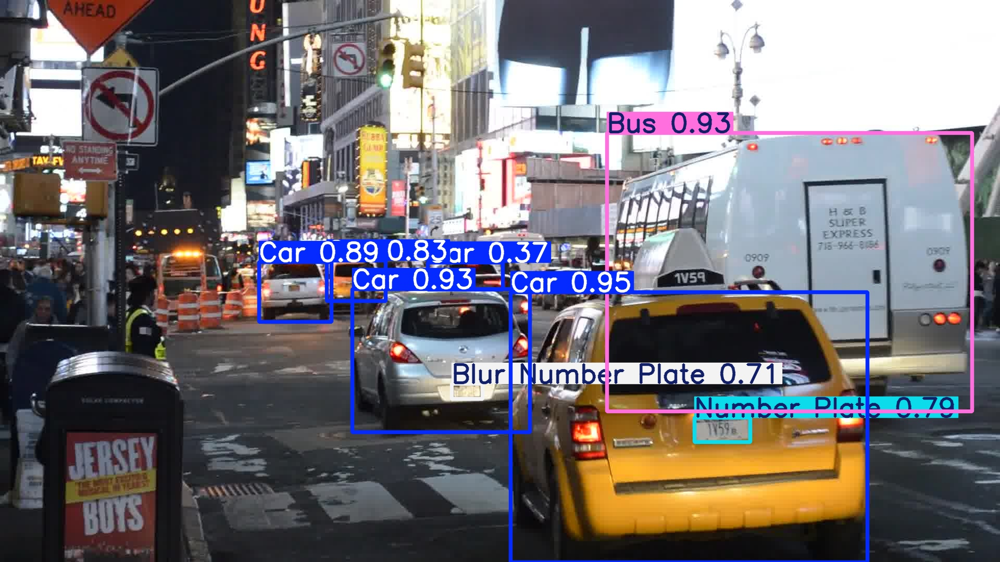

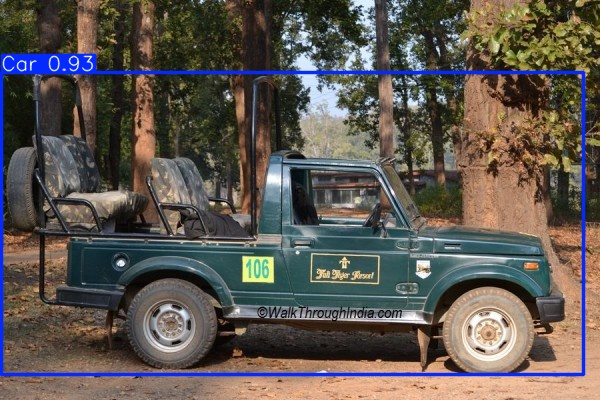

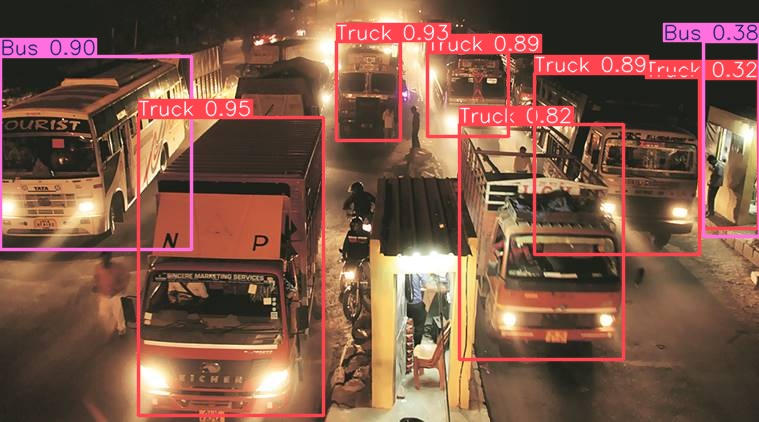

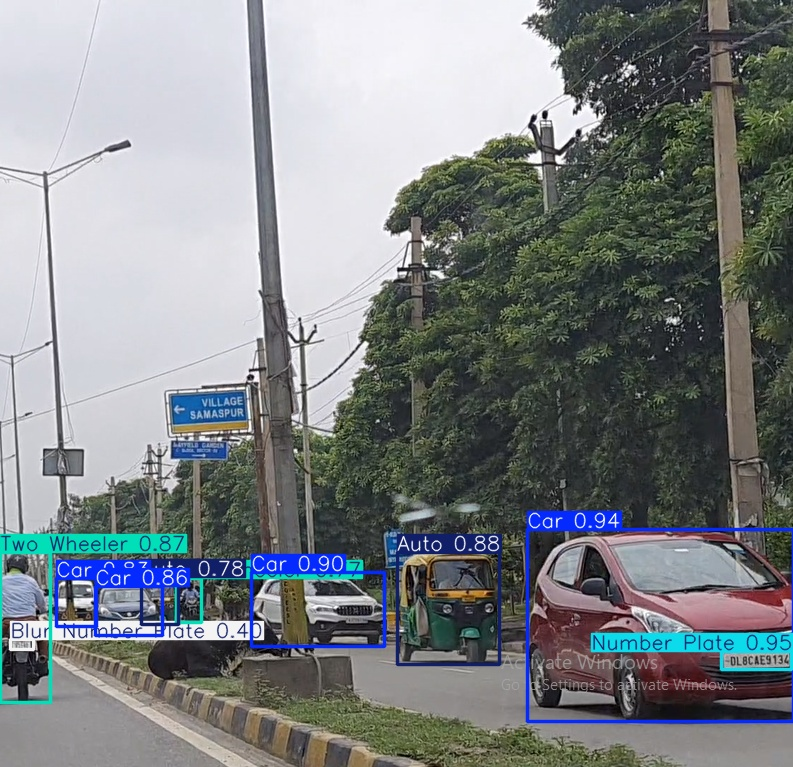

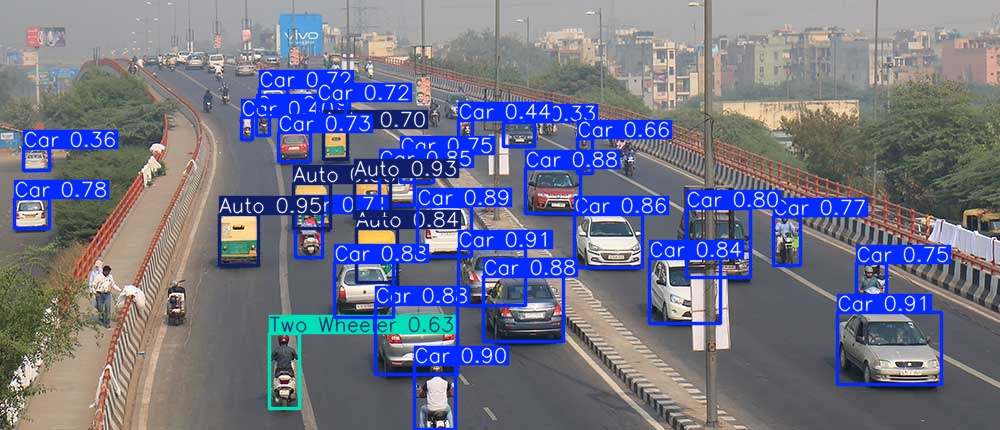

In [10]:
from IPython.display import Image, display

output_dir = '/kaggle/working/runs/detect/predict'
output_images = os.listdir(output_dir)

for image_name in output_images:
    if image_name.endswith('.jpg') or image_name.endswith('.png'):
        display(Image(filename=os.path.join(output_dir, image_name)))

## Step 6: Training the Model with augmented data

In [11]:
!yolo detect train data=/kaggle/working/dataset.yaml model=yolo11s.pt epochs=50 imgsz=640 augment=True

Ultralytics 8.3.110 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/kaggle/working/dataset.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, lin

## Step 7: Reviewing Traning Results (Augmented data)

In [12]:
results_path = '/kaggle/working/runs/detect/train2/results.csv'

results = pd.read_csv(results_path)

In [13]:
results

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,13.6870,1.31588,3.55310,1.18945,0.17495,0.15991,0.15656,0.12126,0.98563,1.95651,1.01040,0.000055,0.000055,0.000055
1,2,18.0930,1.05488,1.97585,1.05414,0.77476,0.26026,0.28107,0.20194,0.95801,3.42721,0.98961,0.000116,0.000116,0.000116
2,3,22.3310,1.03025,1.30673,1.01470,0.68381,0.37452,0.38479,0.26451,0.97618,2.24633,0.97908,0.000175,0.000175,0.000175
3,4,26.4995,1.01787,1.14107,1.00692,0.70372,0.39169,0.45331,0.32564,0.88476,1.50360,0.93034,0.000231,0.000231,0.000231
4,5,30.5556,0.99057,1.06978,0.99063,0.54479,0.52292,0.53206,0.34604,0.92081,1.31524,0.93529,0.000285,0.000285,0.000285
5,6,34.4826,0.99234,1.09942,0.99258,0.54478,0.60700,0.58950,0.36455,0.97051,1.57242,0.96496,0.000336,0.000336,0.000336
6,7,38.4339,0.95406,0.92582,0.97097,0.62753,0.61410,0.64966,0.41476,0.95643,1.22355,0.96899,0.000384,0.000384,0.000384
7,8,42.2291,0.91978,0.86348,0.96337,0.75407,0.62381,0.70762,0.46830,0.90245,1.07172,0.94595,0.000431,0.000431,0.000431
8,9,46.1541,0.87847,0.78531,0.94661,0.68450,0.68566,0.71941,0.47301,0.88352,0.94744,0.93916,0.000474,0.000474,0.000474
9,10,50.0539,0.88352,0.77410,0.95233,0.72259,0.70836,0.75118,0.49727,0.84693,0.78784,0.92551,0.000515,0.000515,0.000515


In [14]:
print(results.columns)

Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')


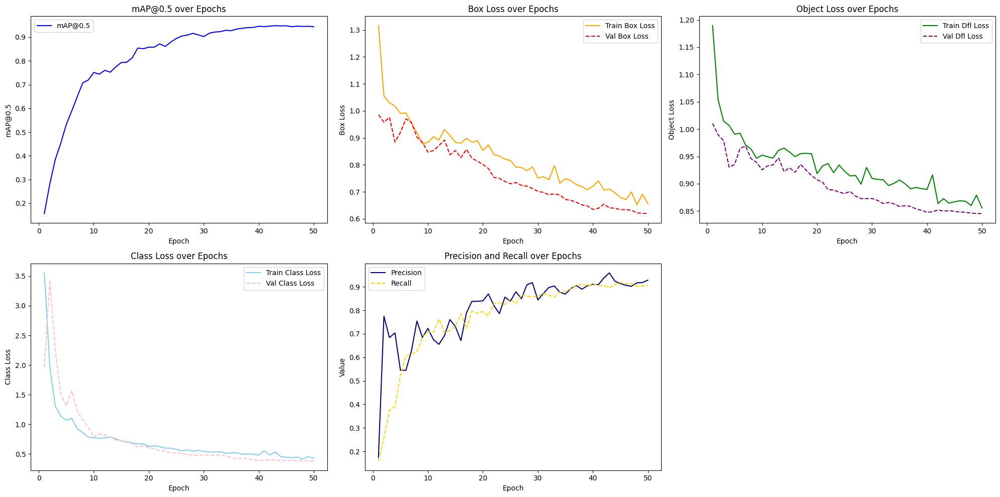

In [15]:
# Plotting results
results = pd.read_csv('/kaggle/working/runs/detect/train2/results.csv')

# Plotting
plt.figure(figsize=(20, 10))

# Subplot 1: mAP@0.5 over epochs
plt.subplot(2, 3, 1)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', color='blue')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5')
plt.title('mAP@0.5 over Epochs')
plt.legend()

# Subplot 2: Training and Validation Box Loss
plt.subplot(2, 3, 2)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', color='orange')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', linestyle='--', color='red')
plt.xlabel('Epoch')
plt.ylabel('Box Loss')
plt.title('Box Loss over Epochs')
plt.legend()

# Subplot 3: Training and Validation Object Loss
plt.subplot(2, 3, 3)
plt.plot(results['epoch'], results['train/dfl_loss'], label='Train Dfl Loss', color='green')
plt.plot(results['epoch'], results['val/dfl_loss'], label='Val Dfl Loss', linestyle='--', color='purple')
plt.xlabel('Epoch')
plt.ylabel('Object Loss')
plt.title('Object Loss over Epochs')
plt.legend()

# Subplot 4: Training and Validation Class Loss
plt.subplot(2, 3, 4)
plt.plot(results['epoch'], results['train/cls_loss'], label='Train Class Loss', color='skyblue')
plt.plot(results['epoch'], results['val/cls_loss'], label='Val Class Loss', linestyle='--', color='pink')
plt.xlabel('Epoch')
plt.ylabel('Class Loss')
plt.title('Class Loss over Epochs')
plt.legend()

# Subplot 5: Precision and Recall
plt.subplot(2, 3, 5)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', color='navy')
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', linestyle='--', color='gold')
plt.xlabel('Epoch')
plt.ylabel('Value')
plt.title('Precision and Recall over Epochs')
plt.legend()


plt.tight_layout()
plt.show()

## Step 8: Performing Inference Tests (Augmented data) 

In [16]:
!yolo detect predict model=runs/detect/train2/weights/best.pt source=/kaggle/input/dataset-traffic/images/test save=True

Ultralytics 8.3.110 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11s summary (fused): 100 layers, 9,415,509 parameters, 0 gradients, 21.3 GFLOPs

image 1/20 /kaggle/input/dataset-traffic/images/test/00 (107).jpg: 640x384 1 Car, 1 Blur Number Plate, 1 Two Wheeler, 2 Buss, 2 Trucks, 82.6ms
image 2/20 /kaggle/input/dataset-traffic/images/test/00 (108).jpg: 640x384 2 Cars, 1 Blur Number Plate, 1 Two Wheeler, 2 Buss, 2 Trucks, 8.6ms
image 3/20 /kaggle/input/dataset-traffic/images/test/00 (180).jpg: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Bus, 63.1ms
image 4/20 /kaggle/input/dataset-traffic/images/test/00 (206).jpg: 384x640 3 Cars, 2 Two Wheelers, 1 Bus, 8.6ms
image 5/20 /kaggle/input/dataset-traffic/images/test/00 (265).jpg: 384x640 4 Cars, 1 Blur Number Plate, 1 Bus, 1 Truck, 9.6ms
image 6/20 /kaggle/input/dataset-traffic/images/test/00 (267).jpg: 384x640 4 Cars, 1 Bus, 1 Truck, 8.3ms
image 7/20 /kaggle/input/dataset-traffic/images/test/00 (292).j

## Step 9: Displaying Inference Results (Augmented data)

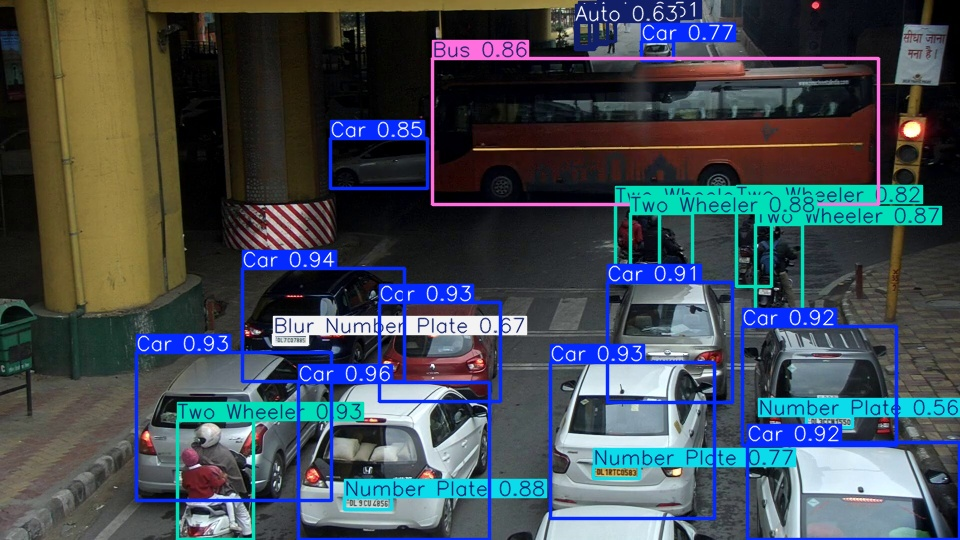

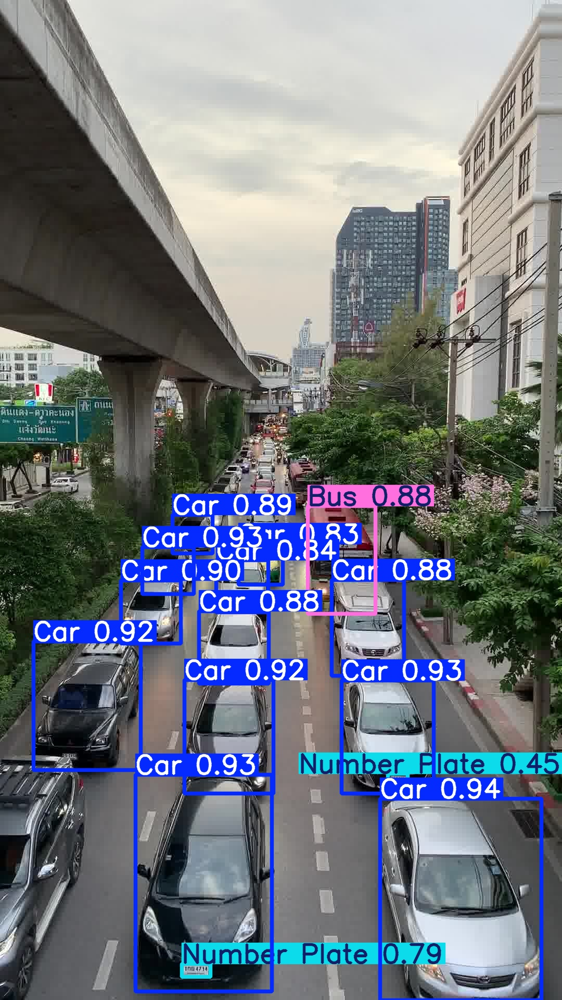

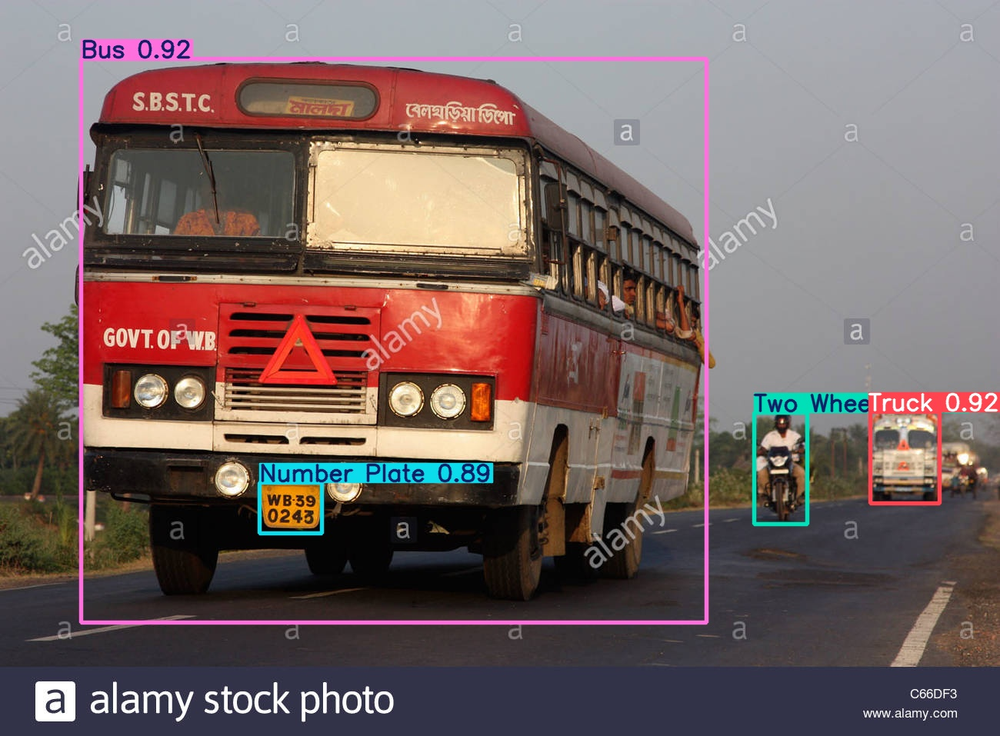

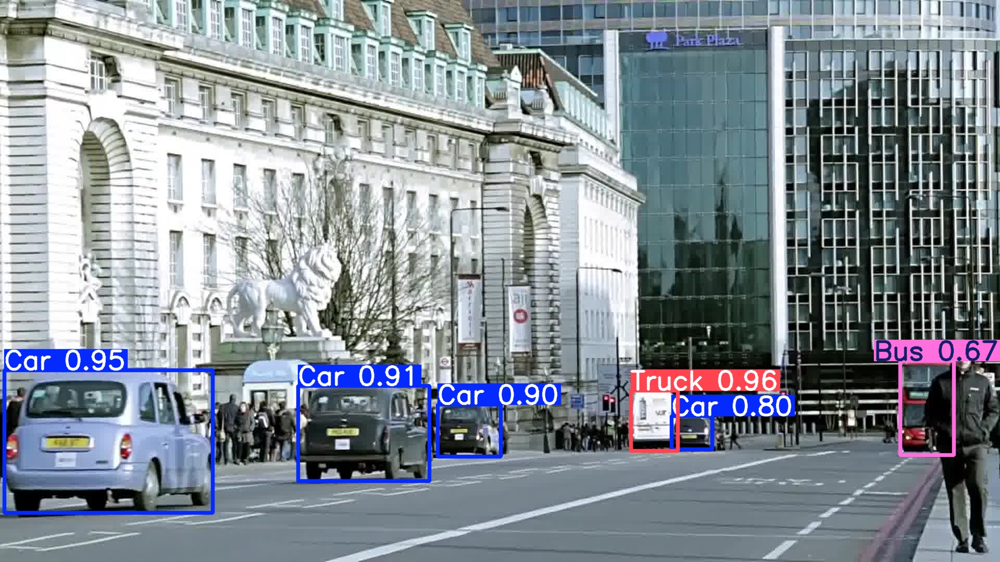

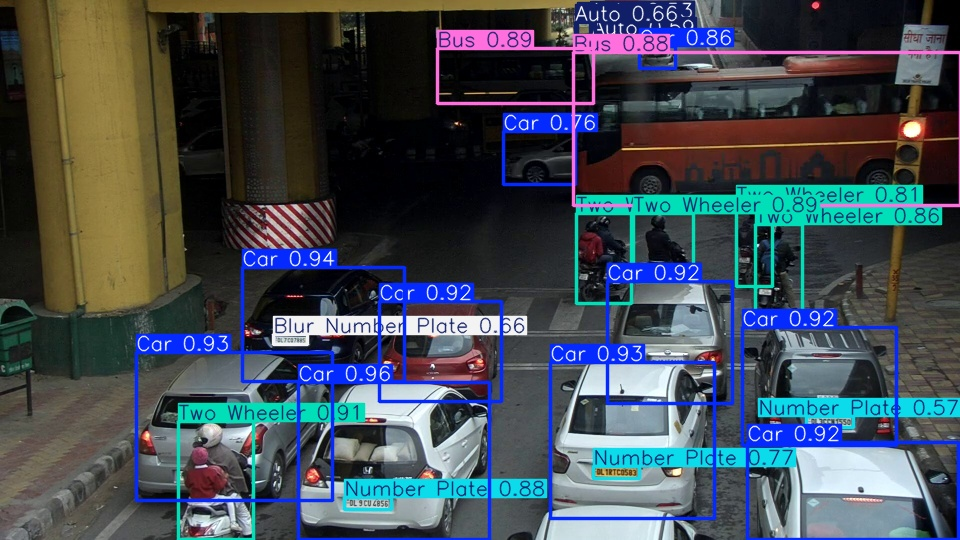

...

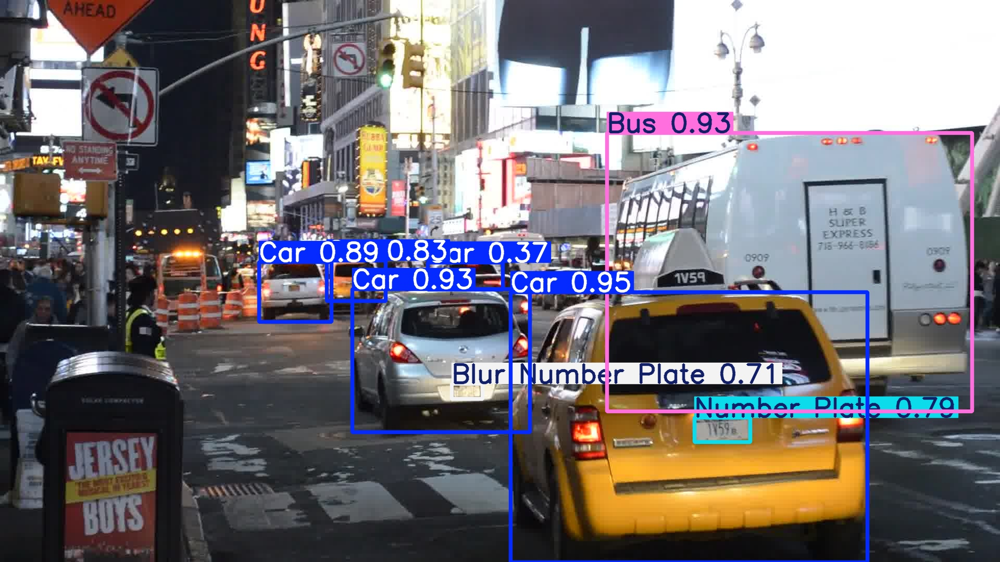

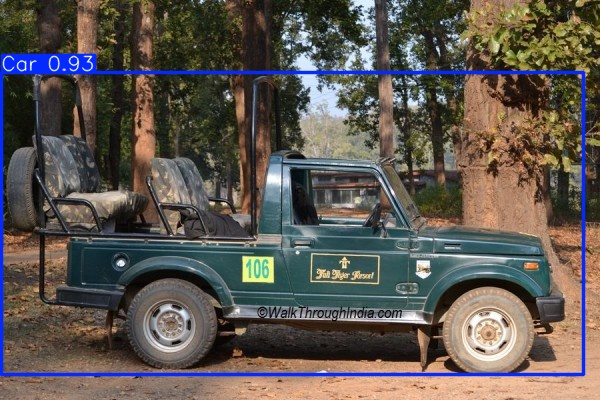

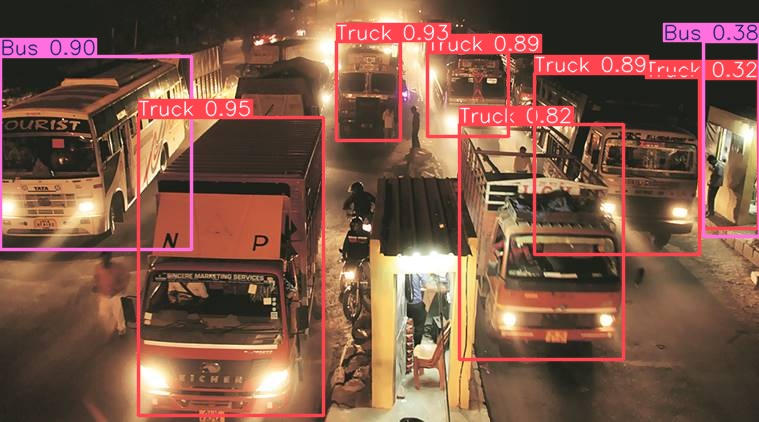

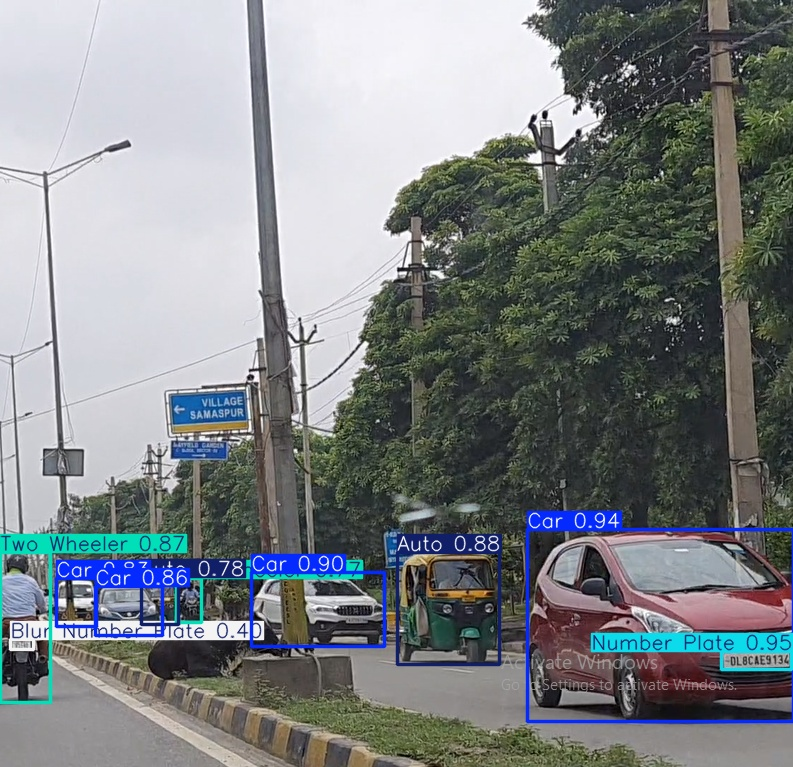

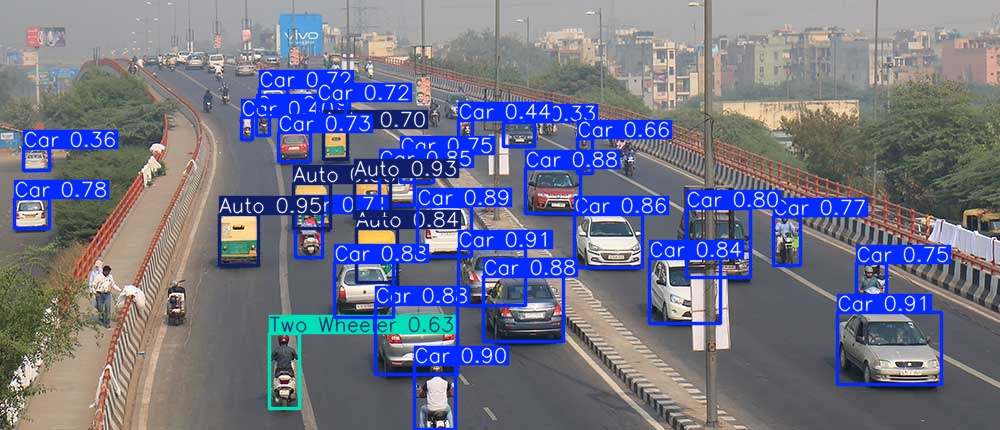

In [17]:
from IPython.display import Image, display

output_dir = '/kaggle/working/runs/detect/predict2'
output_images = os.listdir(output_dir)

for image_name in output_images:
    if image_name.endswith('.jpg') or image_name.endswith('.png'):
        display(Image(filename=os.path.join(output_dir, image_name)))